# Preprocesamiento y ejecución de modelos individuales (Enfoque 1)

En esta sección se abordan las etapas de preprocesamiento de datos y la prueba de modelos de detección de anomalías aplicados de forma individual a cada cliente de Contugas. El objetivo es preparar adecuadamente los datos operativos —como volumen, presión y temperatura— para garantizar la calidad y consistencia necesarias en el entrenamiento de los modelos.

El enfoque individualizado permite capturar las particularidades del comportamiento de cada cliente, mejorando la sensibilidad y precisión en la identificación de anomalías. Se exploran diferentes técnicas de modelado, ajustadas a las características de cada serie temporal, para evaluar su desempeño y adecuación al contexto operativo.

## Preprocesamiento

## Librerías

In [23]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import seaborn as sns
from sklearn.impute import KNNImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt


## Carga de datos

In [2]:
# Carga de datos y concatenación en un df
path=('../data/raw/Datos.xlsx')
df = pd.concat( [df.assign(**{'Cliente': sheet_name}) for sheet_name, df in pd.read_excel(path, sheet_name=None).items()], ignore_index=True)
df['Fecha'] = pd.to_datetime(df['Fecha'])

In [3]:
df

,Fecha,Presion,Temperatura,Volumen,Cliente
0,2019-01-14 00:00:00,17.732563,28.209354,20.969751,CLIENTE1
1,2019-01-14 01:00:00,17.747776,28.518614,17.845739,CLIENTE1
2,2019-01-14 02:00:00,17.758916,28.230191,20.975914,CLIENTE1
3,2019-01-14 03:00:00,17.727940,27.811509,20.592299,CLIENTE1
4,2019-01-14 04:00:00,17.746484,27.795293,21.690626,CLIENTE1
...,...,...,...,...,...
847955,2023-12-31 19:00:00,15.751139,27.460652,204.457549,CLIENTE20
847956,2023-12-31 20:00:00,15.614858,27.010382,186.512096,CLIENTE20
847957,2023-12-31 21:00:00,15.598944,26.709100,204.456461,CLIENTE20
847958,2023-12-31 22:00:00,15.730040,27.266090,203.695596,CLIENTE20


## 1. Preprocesamiento base de los datos

### 1.1 Imputación de valores faltantes

Se selecciona el mejor método para realizar la imputación de los datos

Se realiza la imputación con el método que arrojó las mejores métricas

In [8]:
# Crear DataFrame completo por cliente con fechas faltantes
df_completo = pd.DataFrame()

for cliente in df['Cliente'].unique():
    # Asegurar una sola fila por fecha: usar promedio si hay duplicados
    df_cliente_raw = df[df['Cliente'] == cliente].copy()
    df_cliente = df_cliente_raw.groupby('Fecha').mean(numeric_only=True).reset_index()
    fecha_min = df_cliente['Fecha'].min()
    fecha_max = df_cliente['Fecha'].max()
    fechas_cliente = pd.date_range(start=fecha_min, end=fecha_max, freq='h')

    # Crear dataframe con fechas completas
    df_cliente = df_cliente.set_index('Fecha').reindex(fechas_cliente)
    df_cliente['Cliente'] = cliente
    df_cliente = df_cliente.reset_index().rename(columns={'index': 'Fecha'})
    df_completo = pd.concat([df_completo, df_cliente], ignore_index=True)

# Marcar valores imputados
for var in ['Volumen', 'Presion', 'Temperatura']:
    df_completo[f'{var}_faltante'] = df_completo[var].isna().astype(int)

# Imputar por interpolación lineal
for var in ['Volumen', 'Presion', 'Temperatura']:
    df_completo[var] = df_completo.groupby('Cliente')[var].transform(lambda x: x.interpolate(method='linear'))


In [13]:
df_completo = df_completo[['Fecha', 'Presion', 'Temperatura', 'Volumen', 'Cliente']]
print(df_completo)

                     Fecha    Presion  Temperatura     Volumen    Cliente
0      2019-01-14 00:00:00  17.732563    28.209354   20.969751   CLIENTE1
1      2019-01-14 01:00:00  17.747776    28.518614   17.845739   CLIENTE1
2      2019-01-14 02:00:00  17.758916    28.230191   20.975914   CLIENTE1
3      2019-01-14 03:00:00  17.727940    27.811509   20.592299   CLIENTE1
4      2019-01-14 04:00:00  17.746484    27.795293   21.690626   CLIENTE1
...                    ...        ...          ...         ...        ...
870235 2023-12-31 19:00:00  15.751139    27.460652  204.457549  CLIENTE20
870236 2023-12-31 20:00:00  15.614858    27.010382  186.512096  CLIENTE20
870237 2023-12-31 21:00:00  15.598944    26.709100  204.456461  CLIENTE20
870238 2023-12-31 22:00:00  15.730040    27.266090  203.695596  CLIENTE20
870239 2023-12-31 23:00:00  15.624457    27.481288  201.534548  CLIENTE20

[870240 rows x 5 columns]


In [10]:
# Inicializar diccionarios
missing_data = {}
missing_percentage = {}

# Agrupar por cliente
for cliente, grupo in df_completo.groupby('Cliente'):
    # Rango de fechas
    fecha_inicio = grupo['Fecha'].min()
    fecha_fin = grupo['Fecha'].max()
    
    # Fechas esperadas por hora
    fechas_completas = pd.date_range(start=fecha_inicio, end=fecha_fin, freq='h')
    fechas_cliente = pd.to_datetime(grupo['Fecha'].values)
    
    # Fechas faltantes
    fechas_faltantes = set(fechas_completas) - set(fechas_cliente)
    
    # Guardar fechas faltantes
    missing_data[cliente] = list(fechas_faltantes)
    
    # Calcular porcentaje
    porcentaje = len(fechas_faltantes) / len(fechas_completas) * 100
    missing_percentage[cliente] = porcentaje

# Mostrar porcentaje de datos faltantes por cliente
missing_percent_df = pd.DataFrame.from_dict(missing_percentage, orient='index', columns=['% Faltante'])
#display(missing_percent_df.sort_values('% Faltante', ascending=False))

# Calcular total de registros faltantes
total_faltantes = sum(len(fechas) for fechas in missing_data.values())
print(f"Total de registros faltantes: {total_faltantes}")


Total de registros faltantes: 0


### 1.2 Reprocesamiento variable volumen

**¿Qué hace STL?**

STL (Seasonal-Trend decomposition using Loess) es una técnica poderosa para descomponer una **serie temporal** en tres componentes principales:

Dada una serie de tiempo \( y_t \), STL la descompone como:

$$
y_t = T_t + S_t + R_t
$$

Donde:

- \( T_t \): tendencia (trend), cambios a largo plazo.  
- \( S_t \): estacionalidad (seasonal), patrones que se repiten (diarios, semanales, etc.).  
- \( R_t \): residuo (remainder), el ruido o error no explicado

---

**¿Cómo lo hace?**

STL usa **Loess smoothing** (una técnica de suavizamiento local) para estimar cada componente iterativamente:

1. **Suaviza** la serie para obtener la tendencia.
2. **Calcula** la estacionalidad restando la tendencia.
3. **Ajusta** los residuos.
4. **Repite** para refinar los componentes.

---

**¿Qué puedes hacer con STL?**

- **Eliminar la estacionalidad**: útil si quieres analizar cambios reales y no los efectos cíclicos.
- **Detección de anomalías**: revisando los residuos.
- **Modelar sólo la tendencia**: para pronósticos a largo plazo.
- **Visualizar el comportamiento real** de tu serie (tendencias, ciclos y eventos inusuales).

In [24]:
# Definir la función para graficar distribuciones de un cliente
def graficar_distribuciones_por_cliente(data, cliente, color, variables=['Presion', 'Temperatura', 'Volumen']):
    """
    Grafica las distribuciones de las variables operativas para un cliente específico.

    Args:
        data (DataFrame): El DataFrame con los datos consolidados.
        cliente (str): El identificador del cliente.
        variables (list): Lista de nombres de las variables a graficar.
    """
    cliente_data = data[data['Cliente'] == cliente]
    plt.figure(figsize=(12, 4))

    for i, var in enumerate(variables, 1):
        plt.subplot(1, len(variables), i)
        sns.histplot(cliente_data[var], kde=True, bins=30, color=color)
        plt.title(f"Distribución de {var} - Cliente: {cliente}")
        plt.xlabel(var)
        plt.ylabel("Frecuencia")

    plt.tight_layout()
    plt.show()

In [19]:
lista_pares_organizados = ['CLIENTE10',
 'CLIENTE13',
 'CLIENTE18',
 'CLIENTE2',
 'CLIENTE12',
 'CLIENTE7',
 'CLIENTE3',
 'CLIENTE11',
 'CLIENTE19',
 'CLIENTE4',
 'CLIENTE9',
 'CLIENTE15',
 'CLIENTE20',
 'CLIENTE6',
 'CLIENTE8',
 'CLIENTE16',
 'CLIENTE1',
 'CLIENTE17',
 'CLIENTE14',
 'CLIENTE5']

In [ ]:
# ELIMINAR LA ESTACIONALIDAD
from statsmodels.tsa.seasonal import STL

def corregir_temp_stl(df, columna='Temperatura'):
    df_stl = pd.DataFrame()

    for cliente in df['Cliente'].unique():
        df_cliente = df[df['Cliente'] == cliente].copy()
        df_cliente = df_cliente.set_index('Fecha').sort_index()

        # Asegura frecuencia horaria
        df_cliente = df_cliente.asfreq('h', method='pad')  # Rellenar valores faltantes

        if df_cliente[columna].isna().sum() > 0 or len(df_cliente) < 48:
            continue  # Evita clientes con demasiados NaN o pocos datos

        try:
            stl = STL(df_cliente[columna], period=24)  # Periodo diario para datos horarios
            resultado = stl.fit()
            # Eliminar estacionalidad (restar el componente estacional)
            df_cliente['Temperatura'] = df_cliente[columna] - resultado.seasonal
        except Exception as e:
            print(f"Error procesando cliente {cliente}: {e}")
            continue

        df_cliente = df_cliente.reset_index()
        df_stl = pd.concat([df_stl, df_cliente], ignore_index=True)

    return df_stl


In [ ]:
# Descomposición de la ST
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import STL

def graficar_descomposicion_stl(df, columna='Temperatura'):
    # Crear figura con subgráficos
    fig, axes = plt.subplots(len(df['Cliente'].unique()), 4, figsize=(20, 4 * len(df['Cliente'].unique())), sharex=True)

    # Si solo hay un cliente, convertir el axes en una lista de una sola fila para evitar errores de indexación
    if len(df['Cliente'].unique()) == 1:
        axes = [axes]

    for i, cliente in enumerate(df['Cliente'].unique()):
        df_cliente = df[df['Cliente'] == cliente].copy()
        df_cliente = df_cliente.set_index('Fecha').sort_index()

        # Asegura que los datos estén a una frecuencia horaria
        df_cliente = df_cliente.asfreq('h', method='pad')

        # Comprobamos que no haya NaNs y que tengamos suficientes datos para realizar la descomposición
        if df_cliente[columna].isna().sum() > 0 or len(df_cliente) < 48:
            continue  # Si hay demasiados NaNs o pocos datos, pasamos al siguiente cliente

        try:
            # Descomposición STL con un periodo diario (24 horas para datos horarios)
            stl = STL(df_cliente[columna], period=24)  # Periodo de 24 horas (diario) para datos horarios
            resultado = stl.fit()

            # Graficamos los componentes: original, tendencia, estacionalidad y residual
            axes[i][0].plot(df_cliente.index, df_cliente[columna], label='Original', color='blue')
            axes[i][0].set_title(f'Cliente {cliente} - Original')
            axes[i][0].grid(True)

            axes[i][1].plot(df_cliente.index, resultado.trend, label='Tendencia', color='green')
            axes[i][1].set_title(f'Cliente {cliente} - Tendencia')
            axes[i][1].grid(True)

            axes[i][2].plot(df_cliente.index, resultado.seasonal, label='Estacionalidad', color='orange')
            axes[i][2].set_title(f'Cliente {cliente} - Estacionalidad')
            axes[i][2].grid(True)

            axes[i][3].plot(df_cliente.index, resultado.resid, label='Residual', color='red')
            axes[i][3].set_title(f'Cliente {cliente} - Residual')
            axes[i][3].grid(True)

        except Exception as e:
            print(f"Error procesando cliente {cliente}: {e}")
            continue

    # Añadir título general
    fig.suptitle('Descomposición STL por Cliente (Temperatura)', fontsize=18)
    
    # Ajuste de la disposición para evitar solapamientos
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


In [ ]:
# ELIMINAR TENDENCIA
from statsmodels.tsa.seasonal import STL

def corregir_temp_stl(df, columna='Temperatura'):
    df_stl = pd.DataFrame()

    for cliente in df['Cliente'].unique():
        df_cliente = df[df['Cliente'] == cliente].copy()
        df_cliente = df_cliente.set_index('Fecha').sort_index()

        # Asegura frecuencia horaria
        df_cliente = df_cliente.asfreq('h', method='pad')  # Rellenar valores faltantes

        if df_cliente[columna].isna().sum() > 0 or len(df_cliente) < 48:
            continue  # Evita clientes con demasiados NaN o pocos datos

        try:
            # Descomposición STL: eliminamos la tendencia (trend) y mantenemos la estacionalidad
            stl = STL(df_cliente[columna], period=24)  # Periodo diario para datos horarios
            resultado = stl.fit()

            # Eliminar la tendencia (restar la tendencia)
            df_cliente['Temperatura'] = df_cliente[columna] - resultado.trend
        except Exception as e:
            print(f"Error procesando cliente {cliente}: {e}")
            continue

        df_cliente = df_cliente.reset_index()
        df_stl = pd.concat([df_stl, df_cliente], ignore_index=True)

    return df_stl



In [77]:
df_corregido = corregir_temp_stl(df_completo)
df_corregido

,Fecha,Presion,Temperatura,Volumen,Cliente
0,2019-01-14 00:00:00,17.732563,0.575216,20.969751,CLIENTE1
1,2019-01-14 01:00:00,17.747776,0.893297,17.845739,CLIENTE1
2,2019-01-14 02:00:00,17.758916,0.613994,20.975914,CLIENTE1
3,2019-01-14 03:00:00,17.727940,0.204748,20.592299,CLIENTE1
4,2019-01-14 04:00:00,17.746484,0.198320,21.690626,CLIENTE1
...,...,...,...,...,...
870235,2023-12-31 19:00:00,15.751139,0.924379,204.457549,CLIENTE20
870236,2023-12-31 20:00:00,15.614858,0.471614,186.512096,CLIENTE20
870237,2023-12-31 21:00:00,15.598944,0.167901,204.456461,CLIENTE20
870238,2023-12-31 22:00:00,15.730040,0.722520,203.695596,CLIENTE20


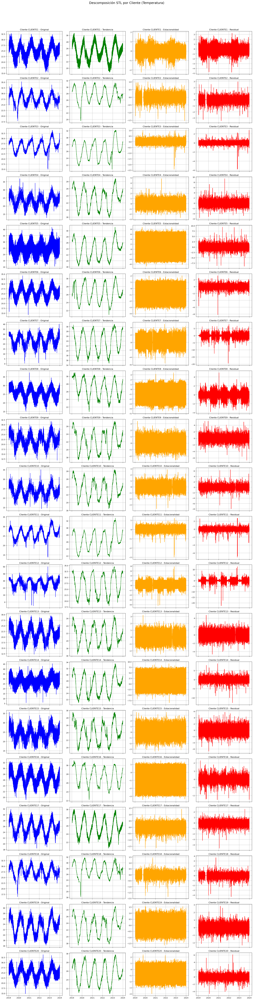

In [74]:
graficar_descomposicion_stl(df_completo, columna='Temperatura')

In [78]:
def plot_series_por_cliente(df, lista_clientes, fecha_col='Fecha'):
    n_clientes = len(lista_clientes)
    fig, axes = plt.subplots(n_clientes, 3, figsize=(18, 4 * n_clientes), sharex=True, sharey=False)

    if n_clientes == 1:
        axes = [axes]  # Para permitir indexar como axes[i][j] aunque solo haya un cliente

    for i, cliente in enumerate(lista_clientes):
        df_cliente = df[df['Cliente'] == cliente].dropna(subset=['Volumen', 'Presion', 'Temperatura'])

        # Volumen
        axes[i][0].plot(df_cliente[fecha_col], df_cliente['Volumen'], color='steelblue')
        axes[i][0].set_ylabel(f'Cliente {cliente}\nVolumen')
        axes[i][0].grid(True)
        axes[i][0].set_ylim(df_cliente['Volumen'].min()-50, df_cliente['Volumen'].max()+50)  # Ajuste del rango del eje Y

        # Presión
        axes[i][1].plot(df_cliente[fecha_col], df_cliente['Presion'], color='darkorange')
        axes[i][1].set_ylabel('Presión')
        axes[i][1].grid(True)
        axes[i][1].set_ylim(df_cliente['Presion'].min(), df_cliente['Presion'].max())  # Ajuste del rango del eje Y

        # Temperatura
        axes[i][2].plot(df_cliente[fecha_col], df_cliente['Temperatura'], color='forestgreen')
        axes[i][2].set_ylabel('Temperatura')
        axes[i][2].grid(True)
        axes[i][2].set_ylim(df_cliente['Temperatura'].min(), df_cliente['Temperatura'].max())  # Ajuste del rango del eje Y

    # Etiquetas X
    for ax in axes[-1]:
        ax.set_xlabel('Fecha')

    # Título
    fig.suptitle('Series de Tiempo por Cliente: Volumen, Presión y Temperatura', fontsize=18)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


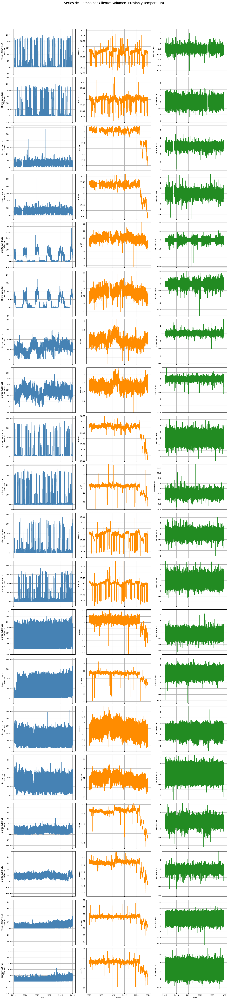

In [ ]:
plot_series_por_cliente(df_corregido, lista_pares_organizados)

###  Escalamiento y Modelos base

In [105]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.ensemble import IsolationForest
from sklearn.svm import OneClassSVM
from sklearn.neighbors import LocalOutlierFactor

# Crear un DataFrame vacío para almacenar las características escaladas y los resultados de anomalías
df_anomalies = pd.DataFrame()
df = df_corregido.copy()

# Iterar sobre cada cliente
for cliente_id, cliente_data in df.groupby('Cliente'):
    # Seleccionar las características a escalar
    features = cliente_data[['Presion', 'Temperatura', 'Volumen']].astype('float32')
    
    # Escalar las características
    scaler = StandardScaler()
    features_scaled = scaler.fit_transform(features)
    
    # Crear un DataFrame con las características escaladas
    cliente_scaled_df = pd.DataFrame(features_scaled, columns=['Presion_scaled', 'Temperatura_scaled', 'Volumen_scaled'])
    cliente_scaled_df['Cliente'] = cliente_id
    cliente_scaled_df['Fecha'] = cliente_data['Fecha'].values  # conservar la fecha real
    
    # Agregar las columnas originales de Presion, Temperatura y Volumen solo para referencia
    cliente_scaled_df['Presion'] = cliente_data['Presion'].values
    cliente_scaled_df['Temperatura'] = cliente_data['Temperatura'].values
    cliente_scaled_df['Volumen'] = cliente_data['Volumen'].values

    # Usar Fecha como índice
    cliente_scaled_df.set_index('Fecha', inplace=True)

    # Aplicar los modelos de detección de anomalías solo sobre las variables escaladas
    dbscan = DBSCAN(eps=0.5, min_samples=5)
    dbscan_labels = dbscan.fit_predict(features_scaled)
    cliente_scaled_df['DBSCAN'] = [1 if label == -1 else 0 for label in dbscan_labels]

    iso_forest = IsolationForest(contamination=0.01)
    iso_forest_labels = iso_forest.fit_predict(features_scaled)
    cliente_scaled_df['IsolationForest'] = [1 if label == -1 else 0 for label in iso_forest_labels]

    one_class_svm = OneClassSVM(nu=0.01, kernel="rbf", gamma="scale")
    ocsvm_labels = one_class_svm.fit_predict(features_scaled)
    cliente_scaled_df['OneClassSVM'] = [1 if label == -1 else 0 for label in ocsvm_labels]

    lof = LocalOutlierFactor(n_neighbors=20, contamination=0.01)
    lof_labels = lof.fit_predict(features_scaled)
    cliente_scaled_df['LOF'] = [1 if label == -1 else 0 for label in lof_labels]

    # Concatenar los resultados
    df_anomalies = pd.concat([df_anomalies, cliente_scaled_df])

# Resultado
df_anomalies.sort_index().head()


,Presion_scaled,Temperatura_scaled,Volumen_scaled,Cliente,Presion,Temperatura,Volumen,DBSCAN,IsolationForest,OneClassSVM,LOF
Fecha,,,,,,,,,,,
2019-01-14,0.548186,0.759369,0.123697,CLIENTE1,17.732563,0.575216,20.969751,0,0,0,0
2019-01-14,0.603074,0.068891,-0.286018,CLIENTE4,17.876279,0.066621,0.000000,0,0,0,0
2019-01-14,0.002977,-0.270206,-0.281865,CLIENTE3,3.568836,-0.081354,106.449413,0,0,0,0
2019-01-14,-0.782593,-0.244001,1.374506,CLIENTE7,17.146564,-0.419411,72.783500,0,0,0,0
2019-01-14,0.002399,0.707004,0.738898,CLIENTE20,17.582113,0.808138,221.710559,0,0,0,0


In [113]:
def graficar_anomalias(df, lista_organizados, modelos=['DBSCAN', 'IsolationForest', 'OneClassSVM', 'LOF'], 
                       colores=['black', 'orange', 'green', 'red']):
    # Asegurarse de que el índice es datetime
    df.index = pd.to_datetime(df.index)

    num_modelos = len(modelos)

    # Iterar sobre los clientes en el orden de la lista proporcionada
    for cliente_id in lista_organizados:
        cliente_data = df[df['Cliente'] == cliente_id]
        if cliente_data.empty:
            print(f"Advertencia: Cliente {cliente_id} no encontrado en los datos.")
            continue

        # Crear la figura con 3 filas (una por variable) y columnas según la cantidad de modelos
        fig, axs = plt.subplots(3, num_modelos, figsize=(5*num_modelos, 12), sharex=True, sharey=False)

        # Asegurar que axs sea siempre una matriz 2D
        if num_modelos == 1:
            axs = axs.reshape(3, 1)

        # Iterar sobre modelos y variables
        for i, (metodo, color) in enumerate(zip(modelos, colores)):
            for j, var in enumerate(['Presion', 'Temperatura', 'Volumen']):
                ax = axs[j, i]

                # Graficar la variable
                ax.plot(cliente_data.index, cliente_data[var], label=var, color='blue', linewidth=1)

                # Puntos de anomalía
                anomalías = cliente_data[cliente_data[metodo] == 1]
                ax.scatter(anomalías.index, anomalías[var], label=f'Anomalías {metodo}', color=color, s=25)

                ax.set_title(f'{var} - {metodo}')
                ax.set_xlabel('Fecha')
                ax.grid(True)
                if i == 0:
                    ax.set_ylabel(var)
                ax.legend()

                # Ajustar el eje Y automáticamente según los valores de la variable para este cliente y cada subplot
                y_min, y_max = cliente_data[var].min(), cliente_data[var].max()
                ax.set_ylim(y_min - 0.1 * (y_max - y_min), y_max + 0.1 * (y_max - y_min))  # Añadir un margen de 10%

        # Título general
        plt.suptitle(f'Anomalías detectadas para Cliente {cliente_id}', fontsize=16)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

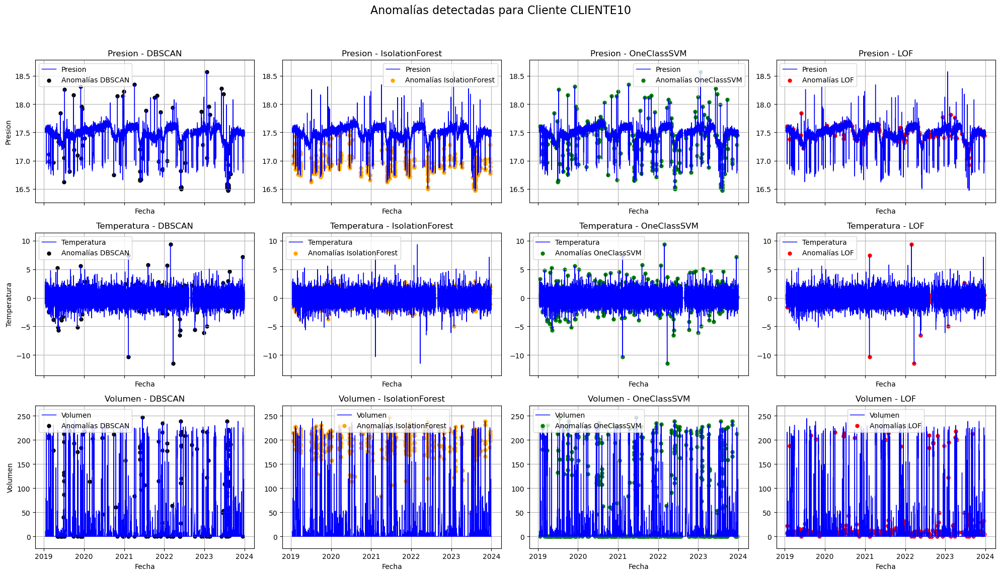

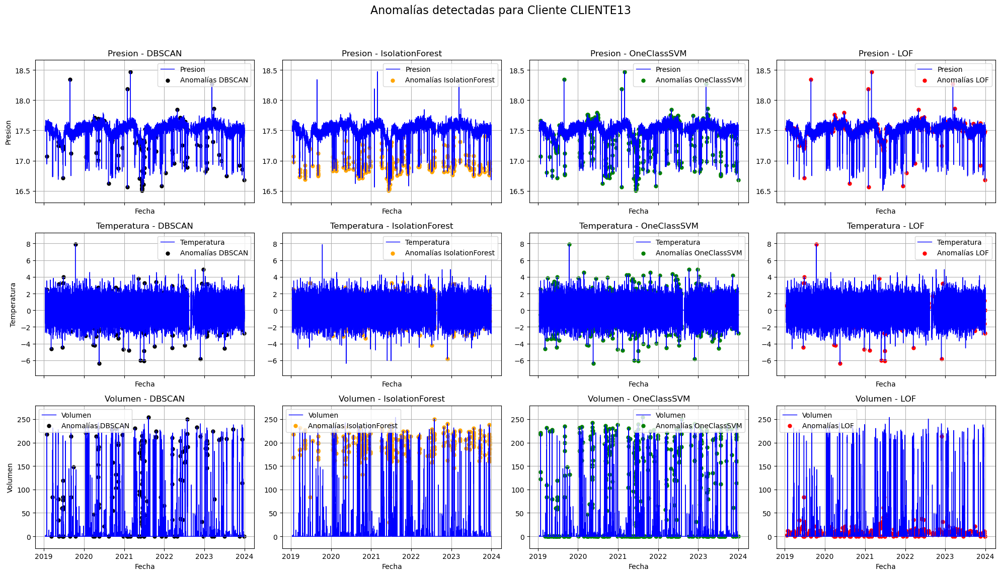

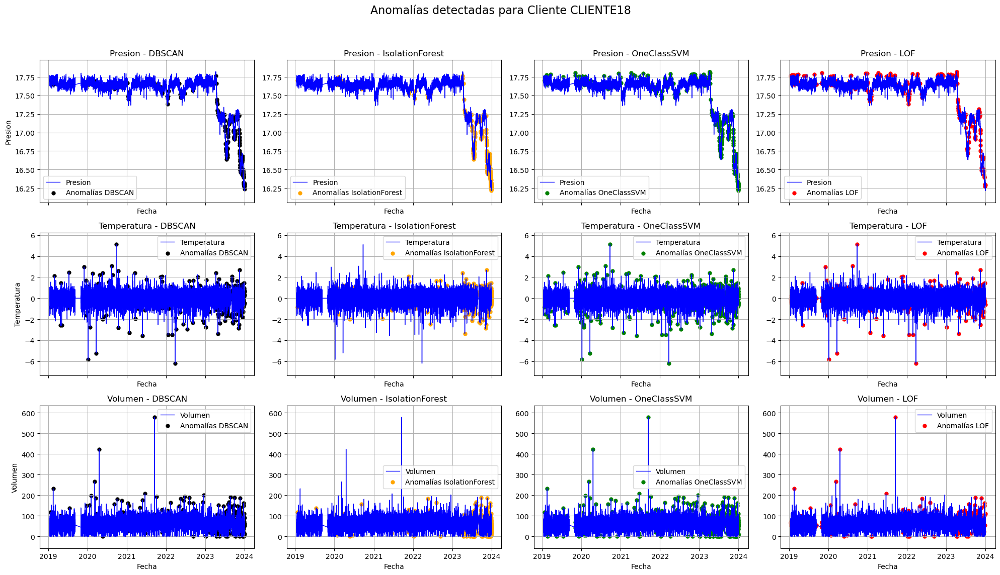

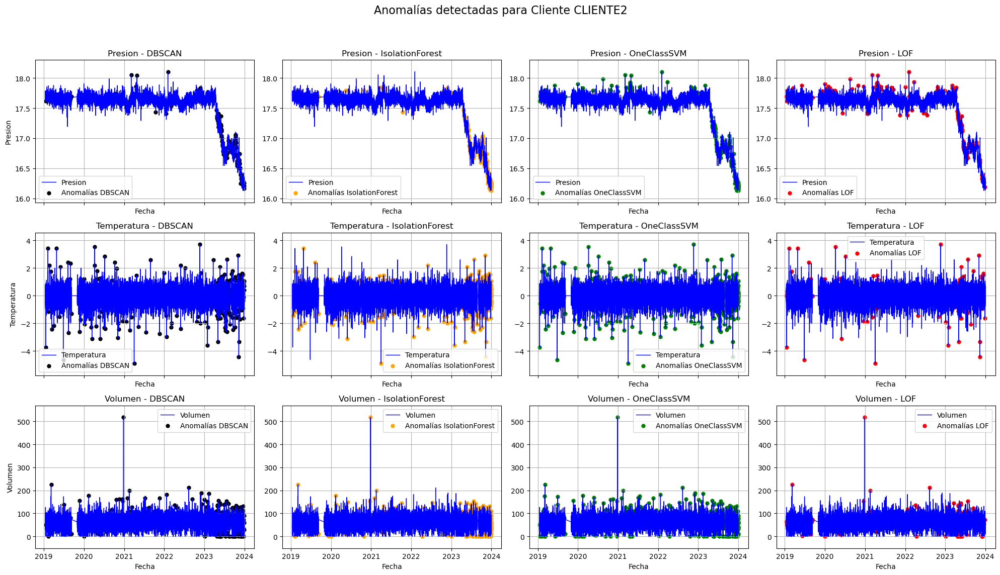

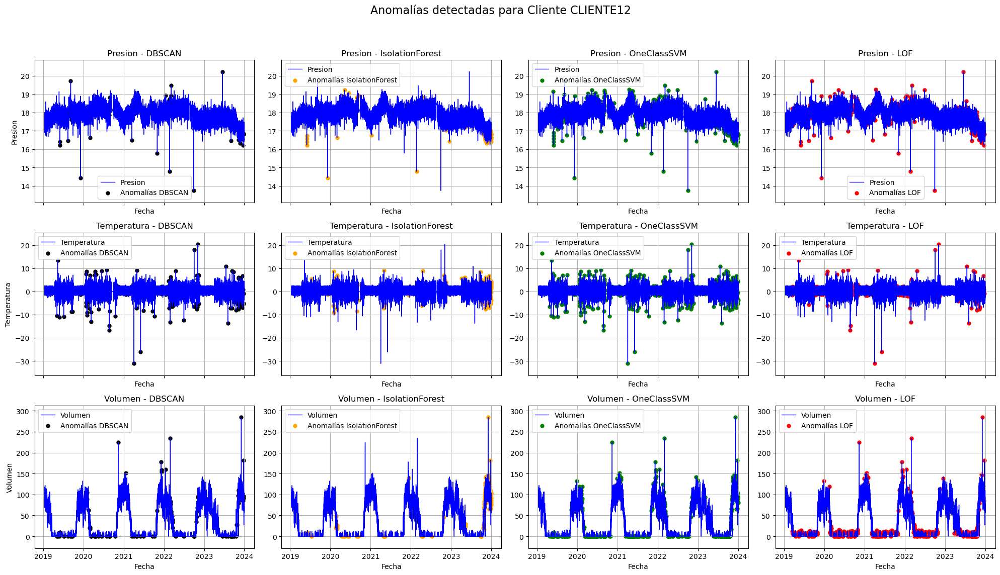

...

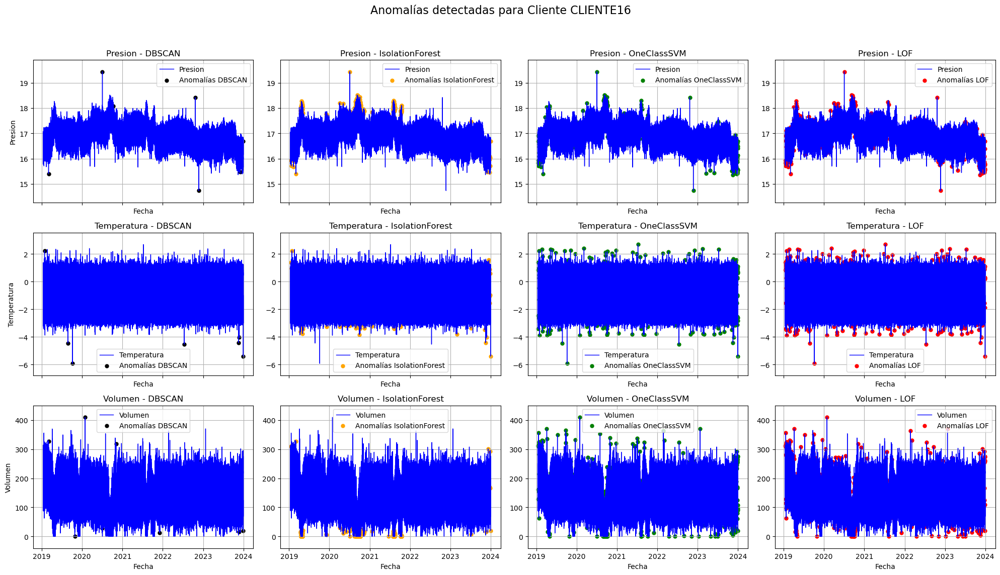

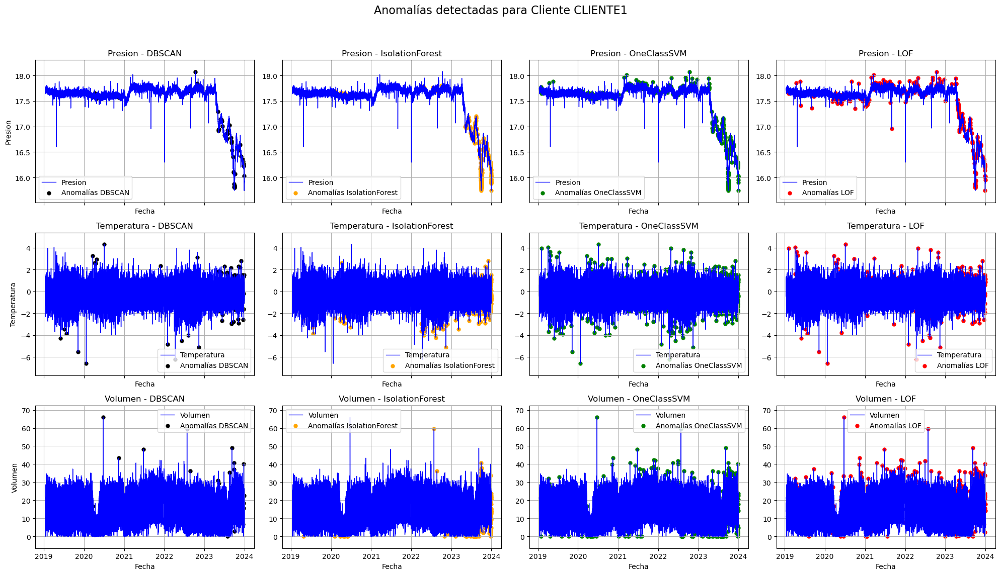

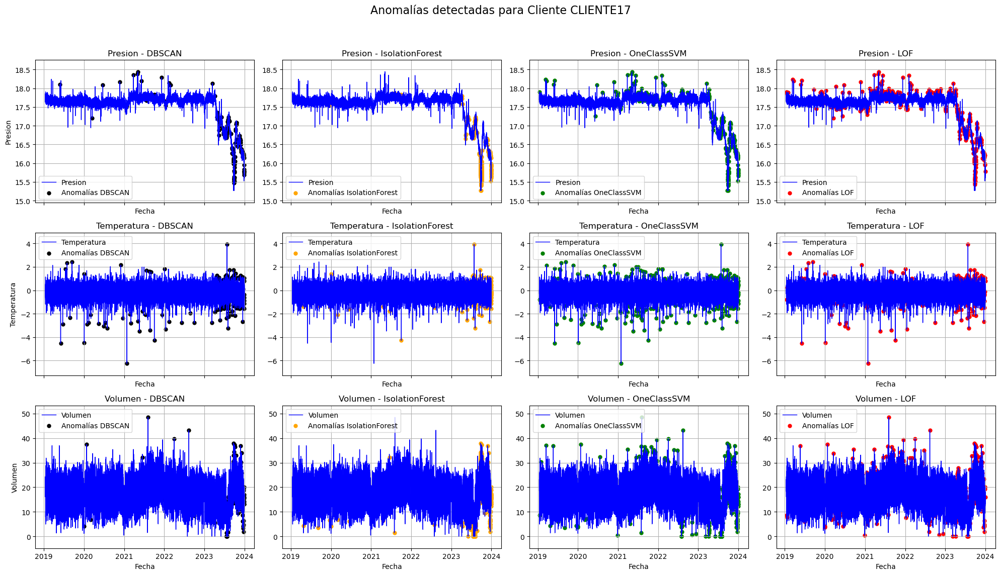

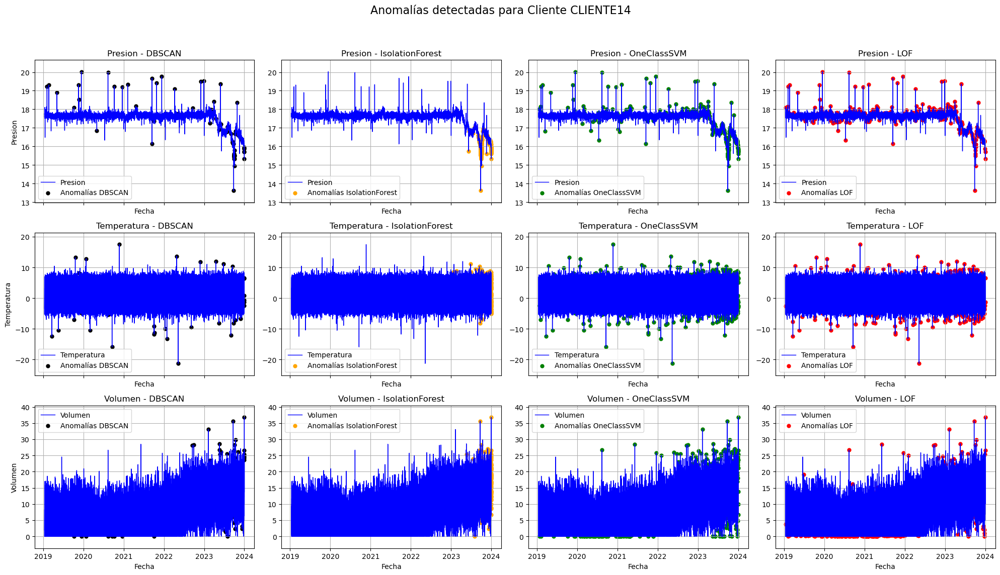

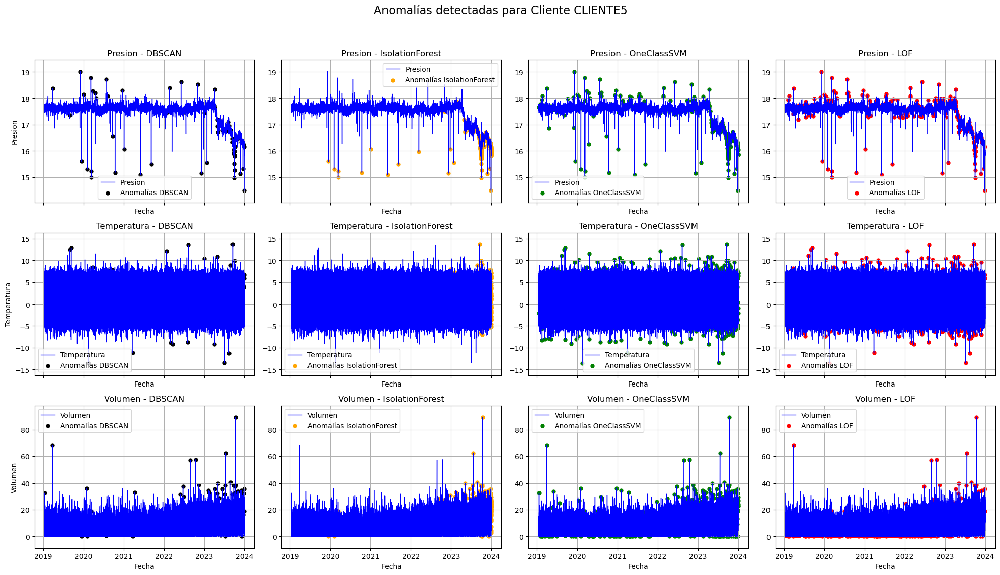

In [114]:
graficar_anomalias(df_anomalies, lista_pares_organizados)

In [108]:
def graficar_clusters_por_cliente(df, lista_organizados, cluster_col='Cluster', palette='tab10'):
    pares = [
        ('Presion', 'Temperatura'),
        ('Temperatura', 'Volumen'),
        ('Volumen', 'Presion')
    ]
    
    for cliente_id in lista_organizados:
        cliente_data = df[df['Cliente'] == cliente_id]
        if cliente_data.empty:
            print(f"Advertencia: Cliente {cliente_id} no encontrado en los datos.")
            continue

        fig, axs = plt.subplots(1, 3, figsize=(18, 5))

        for ax, (x, y) in zip(axs, pares):
            sns.scatterplot(data=cliente_data, x=x, y=y, hue=cluster_col,
                            palette=palette, s=40, edgecolor='k', alpha=0.7, ax=ax)
            ax.set_title(f'{y} vs {x}')
            ax.set_xlabel(x)
            ax.set_ylabel(y)
            ax.grid(True)

        fig.suptitle(f'Clusters para Cliente {cliente_id}', fontsize=16)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.legend(title='Cluster')
        plt.show()


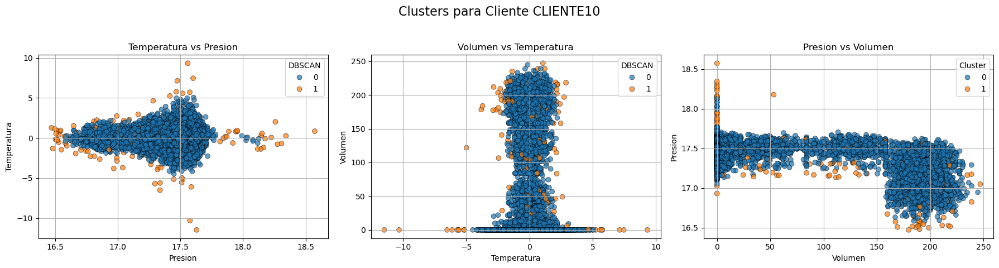

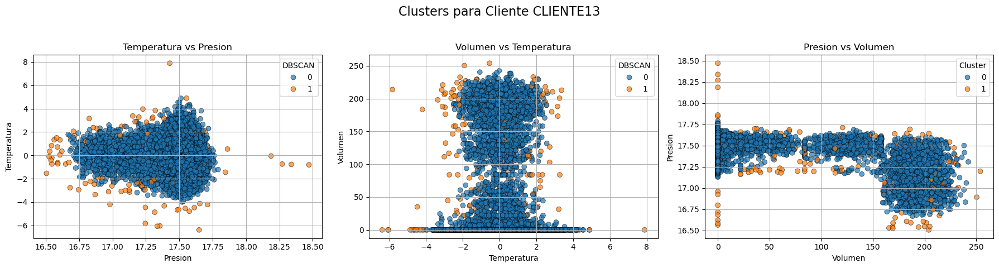

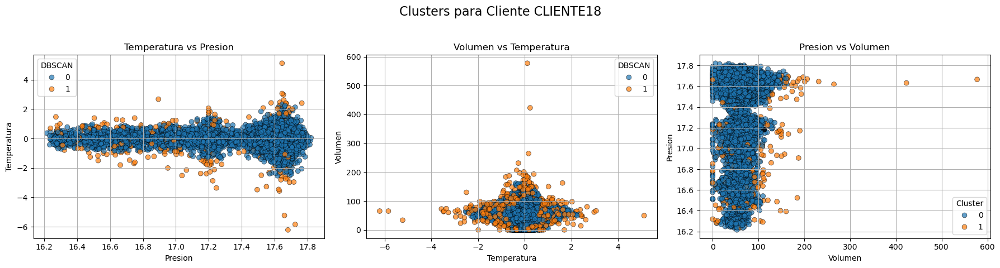

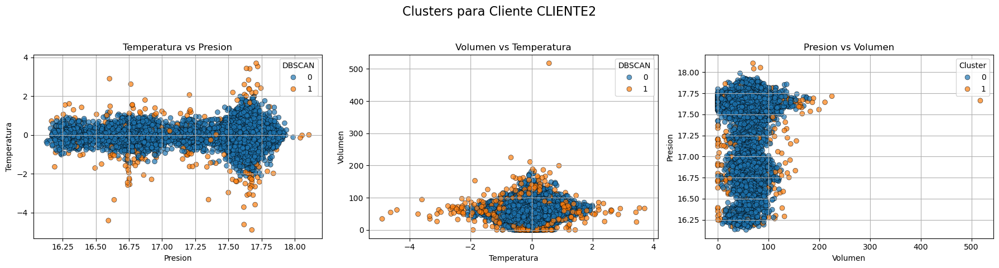

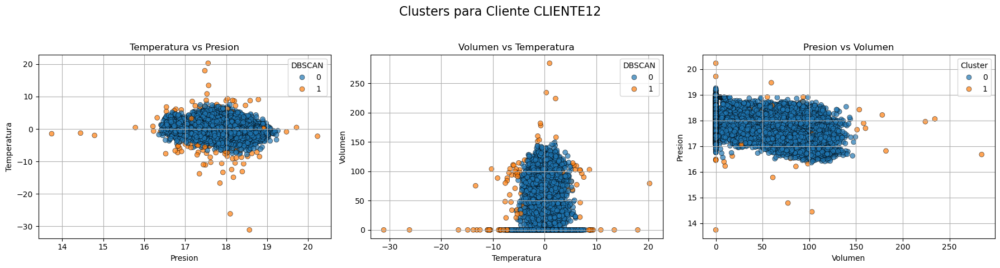

...

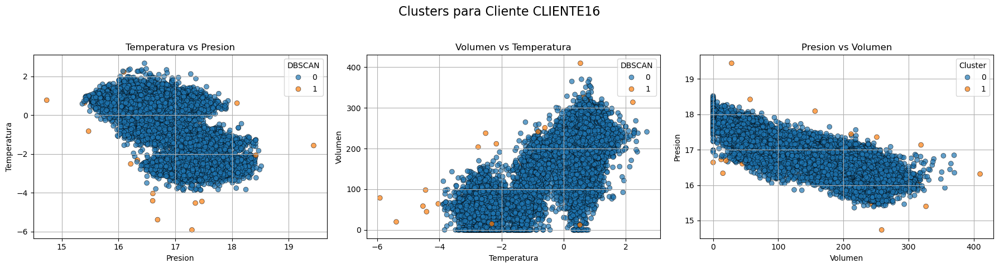

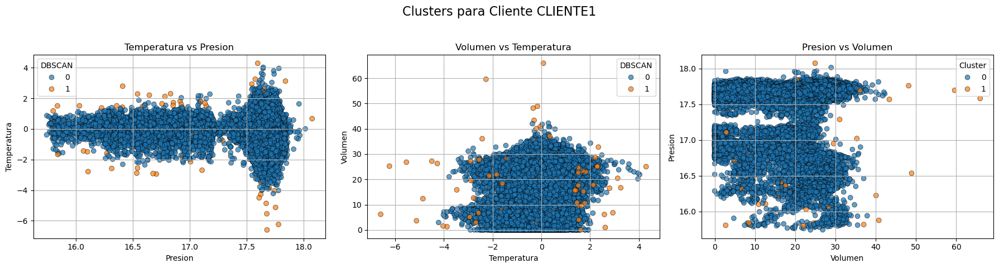

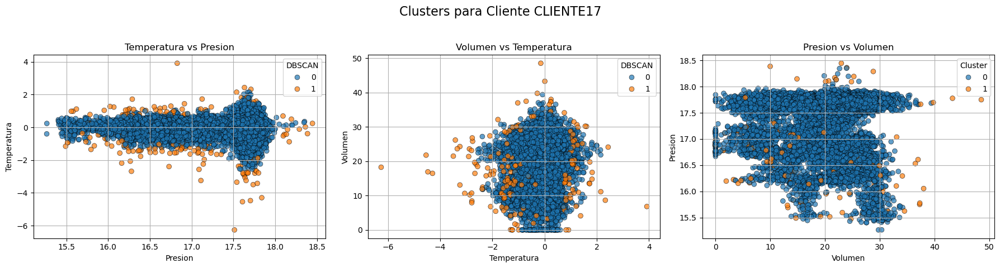

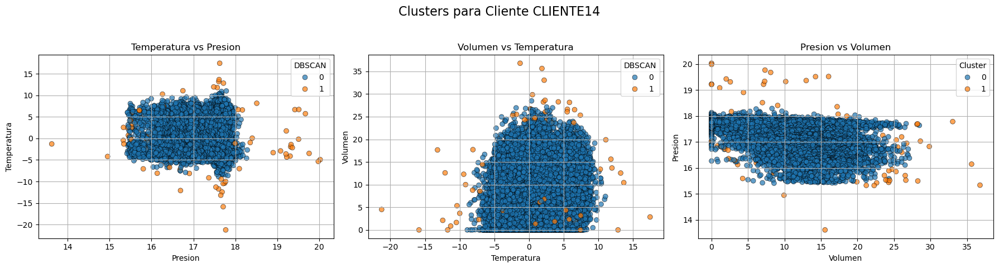

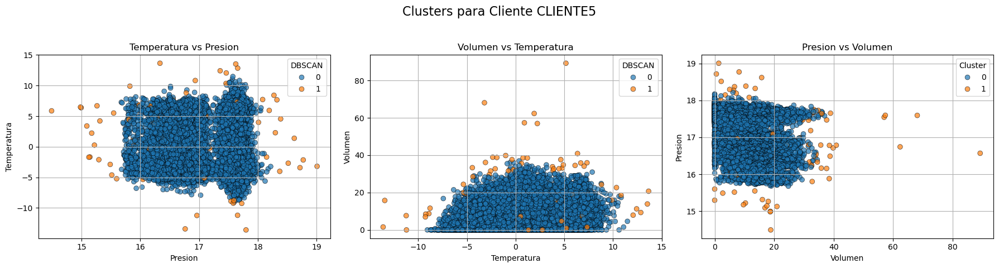

In [109]:
graficar_clusters_por_cliente(df_anomalies, lista_pares_organizados, cluster_col='DBSCAN')

In [ ]:
**Observaciones**
**Cliente 10:**
- DBSCAN
Mes 4

In [116]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.ensemble import IsolationForest
from sklearn.svm import OneClassSVM
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import silhouette_score, davies_bouldin_score

def evaluar_anomalias(df_corregido):
    # Crear un DataFrame vacío para almacenar las características escaladas y los resultados de anomalías
    df_anomalies = pd.DataFrame()
    resultados = []

    # Iterar sobre cada cliente
    for cliente_id, cliente_data in df_corregido.groupby('Cliente'):
        # Seleccionar las características a escalar
        features = cliente_data[['Presion', 'Temperatura', 'Volumen']].astype('float32')
        
        # Escalar las características
        scaler = StandardScaler()
        features_scaled = scaler.fit_transform(features)
        
        # Crear un DataFrame con las características escaladas
        cliente_scaled_df = pd.DataFrame(features_scaled, columns=['Presion_scaled', 'Temperatura_scaled', 'Volumen_scaled'])
        cliente_scaled_df['Cliente'] = cliente_id
        cliente_scaled_df['Fecha'] = cliente_data['Fecha'].values  # conservar la fecha real
        
        # Agregar las columnas originales de Presion, Temperatura y Volumen solo para referencia
        cliente_scaled_df['Presion'] = cliente_data['Presion'].values
        cliente_scaled_df['Temperatura'] = cliente_data['Temperatura'].values
        cliente_scaled_df['Volumen'] = cliente_data['Volumen'].values

        # Usar Fecha como índice
        cliente_scaled_df.set_index('Fecha', inplace=True)

        # Aplicar los modelos de detección de anomalías solo sobre las variables escaladas
        dbscan = DBSCAN(eps=0.5, min_samples=5)
        dbscan_labels = dbscan.fit_predict(features_scaled)
        cliente_scaled_df['DBSCAN'] = [1 if label == -1 else 0 for label in dbscan_labels]

        iso_forest = IsolationForest(contamination=0.01)
        iso_forest_labels = iso_forest.fit_predict(features_scaled)
        cliente_scaled_df['IsolationForest'] = [1 if label == -1 else 0 for label in iso_forest_labels]

        one_class_svm = OneClassSVM(nu=0.01, kernel="rbf", gamma="scale")
        ocsvm_labels = one_class_svm.fit_predict(features_scaled)
        cliente_scaled_df['OneClassSVM'] = [1 if label == -1 else 0 for label in ocsvm_labels]

        lof = LocalOutlierFactor(n_neighbors=20, contamination=0.01)
        lof_labels = lof.fit_predict(features_scaled)
        cliente_scaled_df['LOF'] = [1 if label == -1 else 0 for label in lof_labels]

        # Concatenar los resultados
        df_anomalies = pd.concat([df_anomalies, cliente_scaled_df])

        # Calcular las métricas de Silhouette y Davies-Bouldin
        for modelo, labels in [('DBSCAN', dbscan_labels), ('IsolationForest', iso_forest_labels), 
                               ('OneClassSVM', ocsvm_labels), ('LOF', lof_labels)]:
            # Usar etiquetas (1: normal, -1: anómalo)
            etiquetas = [1 if label == -1 else 0 for label in labels]
            if len(set(etiquetas)) > 1:  # Silhouette solo tiene sentido si hay al menos 2 grupos
                silhouette = silhouette_score(features_scaled, etiquetas)
            else:
                silhouette = np.nan

            if len(set(etiquetas)) > 1:  # Davies-Bouldin solo tiene sentido si hay al menos 2 grupos
                davies_bouldin = davies_bouldin_score(features_scaled, etiquetas)
            else:
                davies_bouldin = np.nan

            resultados.append({
                'Cliente': cliente_id,
                'Modelo': modelo,
                'Silhouette': silhouette,
                'Davies-Bouldin': davies_bouldin
            })

    # Convertir resultados a DataFrame
    df_resultados = pd.DataFrame(resultados)
    
    # Devolver ambos DataFrames: anomalías y resultados de métricas
    return df_anomalies.sort_index(), df_resultados


In [117]:

# Usar la función
df_anomalies, df_resultados = evaluar_anomalias(df_corregido)

In [121]:
print(df_resultados)

      Cliente           Modelo  Silhouette  Davies-Bouldin
0    CLIENTE1           DBSCAN    0.548897        3.091330
1    CLIENTE1  IsolationForest    0.505444        1.052955
2    CLIENTE1      OneClassSVM    0.469896        3.634292
3    CLIENTE1              LOF    0.288986        8.218724
4   CLIENTE10           DBSCAN    0.653762        2.471422
..        ...              ...         ...             ...
75   CLIENTE8              LOF    0.229976       21.583616
76   CLIENTE9           DBSCAN    0.654822        1.950239
77   CLIENTE9  IsolationForest    0.720089        0.472753
78   CLIENTE9      OneClassSVM    0.577950        2.194908
79   CLIENTE9              LOF    0.051913       10.160386

[80 rows x 4 columns]


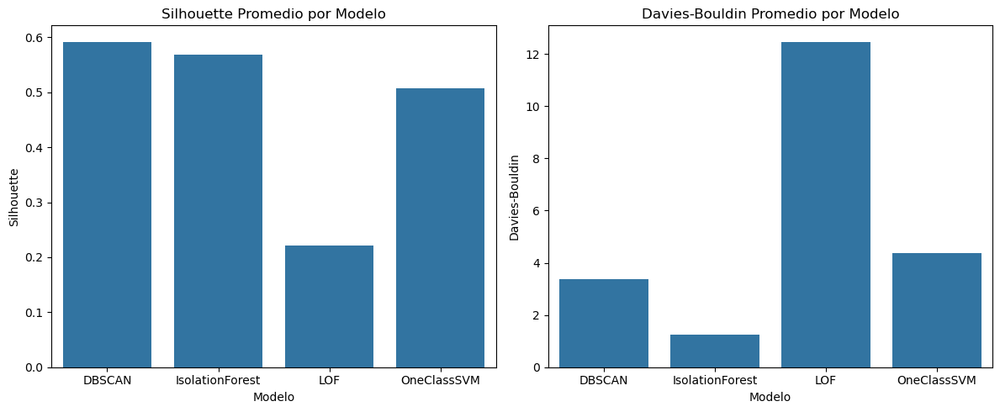

In [125]:
df_model_avg = df_resultados.groupby('Modelo')[['Silhouette', 'Davies-Bouldin']].mean().reset_index()

fig, ax1 = plt.subplots(1, 2, figsize=(12,5))

sns.barplot(data=df_model_avg, x='Modelo', y='Silhouette', ax=ax1[0])
ax1[0].set_title('Silhouette Promedio por Modelo')

sns.barplot(data=df_model_avg, x='Modelo', y='Davies-Bouldin', ax=ax1[1])
ax1[1].set_title('Davies-Bouldin Promedio por Modelo')

plt.tight_layout()
plt.show()

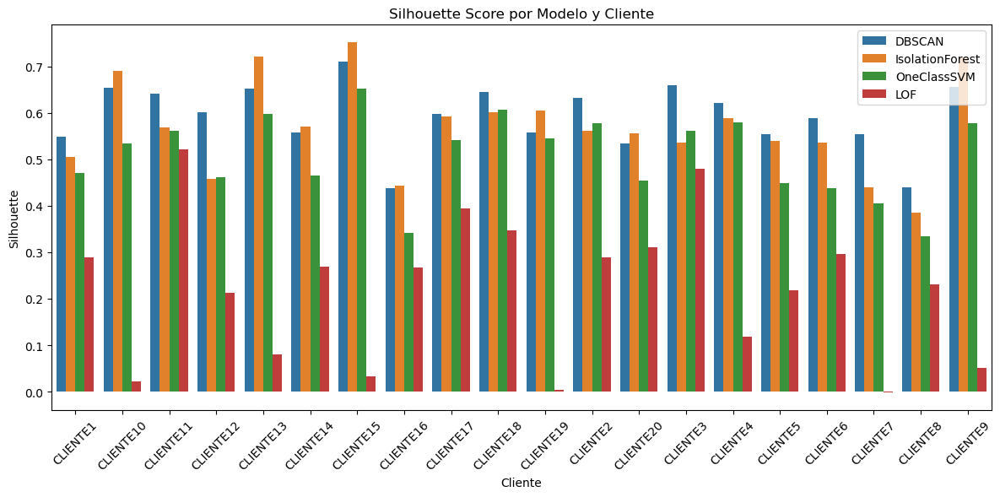

In [122]:
plt.figure(figsize=(12,6))
sns.barplot(data=df_resultados, x='Cliente', y='Silhouette', hue='Modelo')
plt.title('Silhouette Score por Modelo y Cliente')
plt.xticks(rotation=45)
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

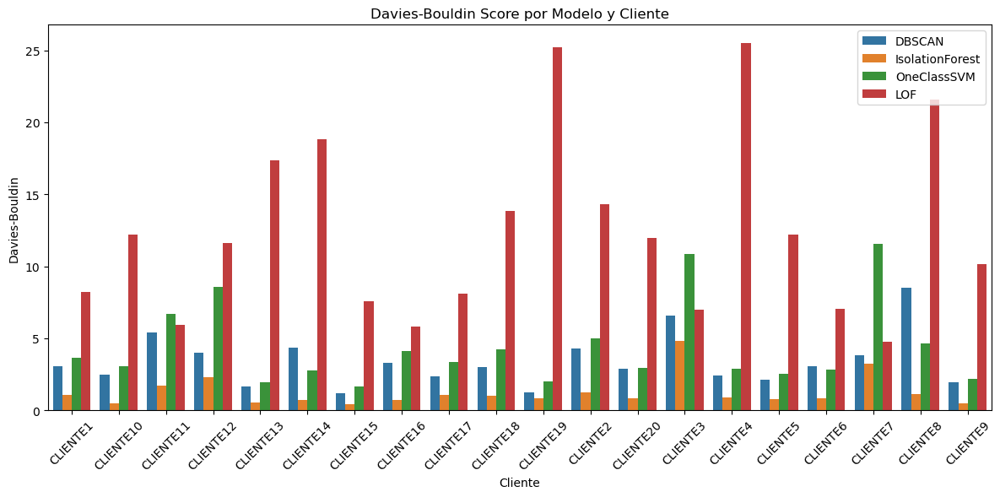

In [123]:
plt.figure(figsize=(12,6))
sns.barplot(data=df_resultados, x='Cliente', y='Davies-Bouldin', hue='Modelo')
plt.title('Davies-Bouldin Score por Modelo y Cliente')
plt.xticks(rotation=45)
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

In [119]:
df_anomalies

,Presion_scaled,Temperatura_scaled,Volumen_scaled,Cliente,Presion,Temperatura,Volumen,DBSCAN,IsolationForest,OneClassSVM,LOF
Fecha,,,,,,,,,,,
2019-01-14 00:00:00,0.548186,0.759369,0.123697,CLIENTE1,17.732563,0.575216,20.969751,0,0,0,0
2019-01-14 00:00:00,0.603074,0.068891,-0.286018,CLIENTE4,17.876279,0.066621,0.000000,0,0,0,0
2019-01-14 00:00:00,0.002977,-0.270206,-0.281865,CLIENTE3,3.568836,-0.081354,106.449413,0,0,0,0
2019-01-14 00:00:00,-0.782593,-0.244001,1.374506,CLIENTE7,17.146564,-0.419411,72.783500,0,0,0,0
2019-01-14 00:00:00,0.002399,0.707004,0.738898,CLIENTE20,17.582113,0.808138,221.710559,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
2023-12-31 23:00:00,-3.276492,0.459721,-0.286018,CLIENTE4,16.372256,0.444794,0.000000,0,0,0,0
2023-12-31 23:00:00,-4.431301,-0.842950,0.561512,CLIENTE5,15.849333,-3.292023,11.417578,0,0,0,0
2023-12-31 23:00:00,-4.763522,-1.358731,-0.159434,CLIENTE6,15.686217,-1.815052,139.281649,0,1,1,0


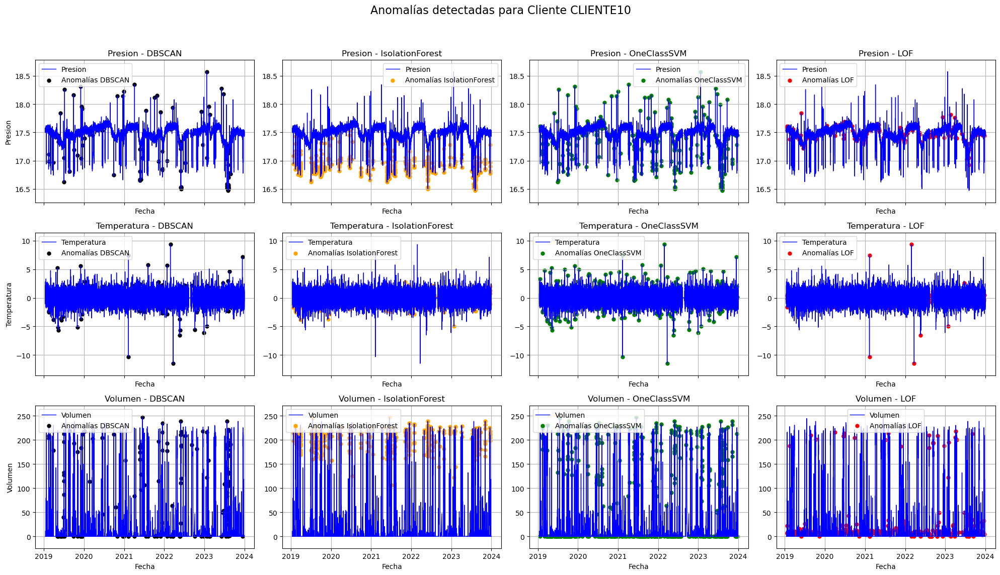

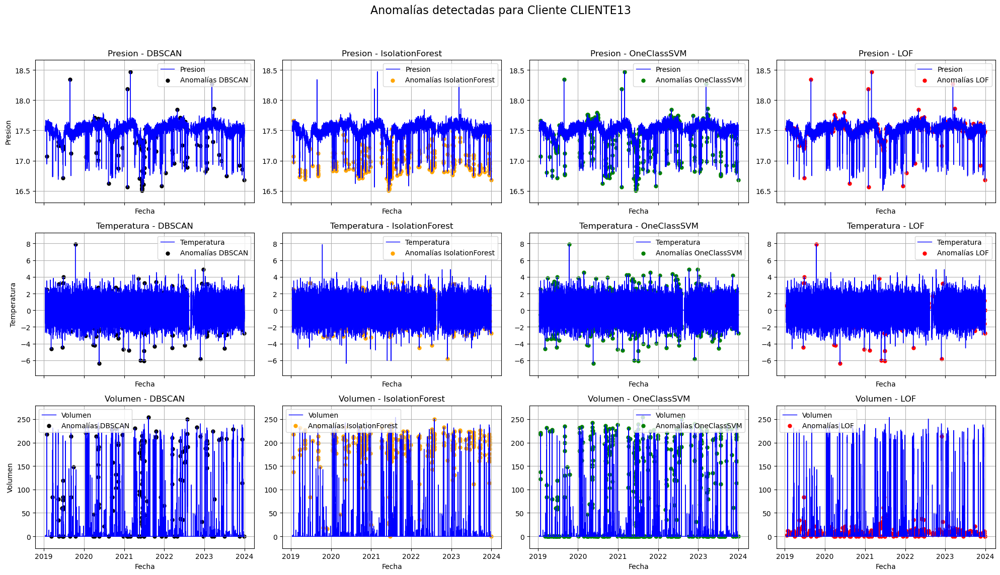

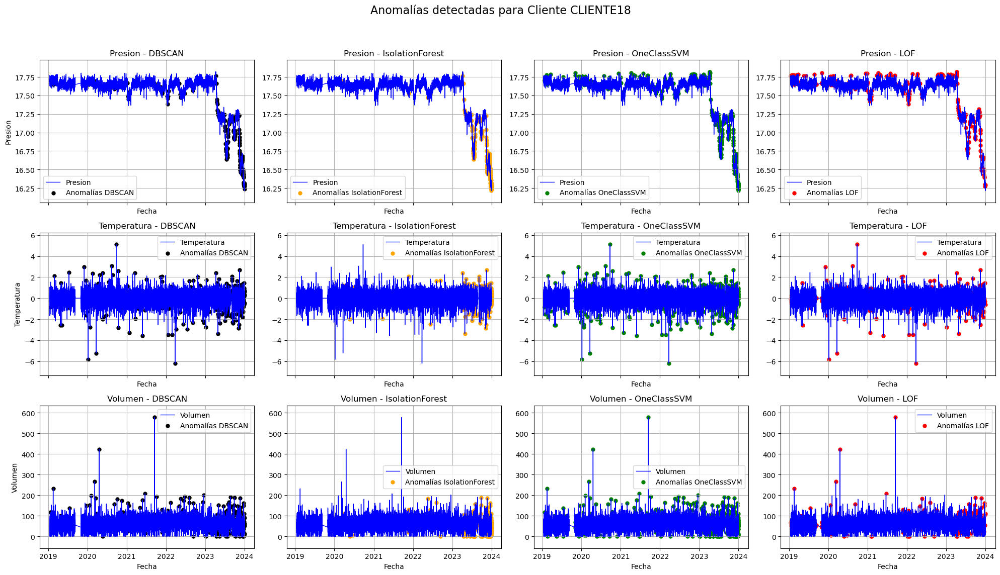

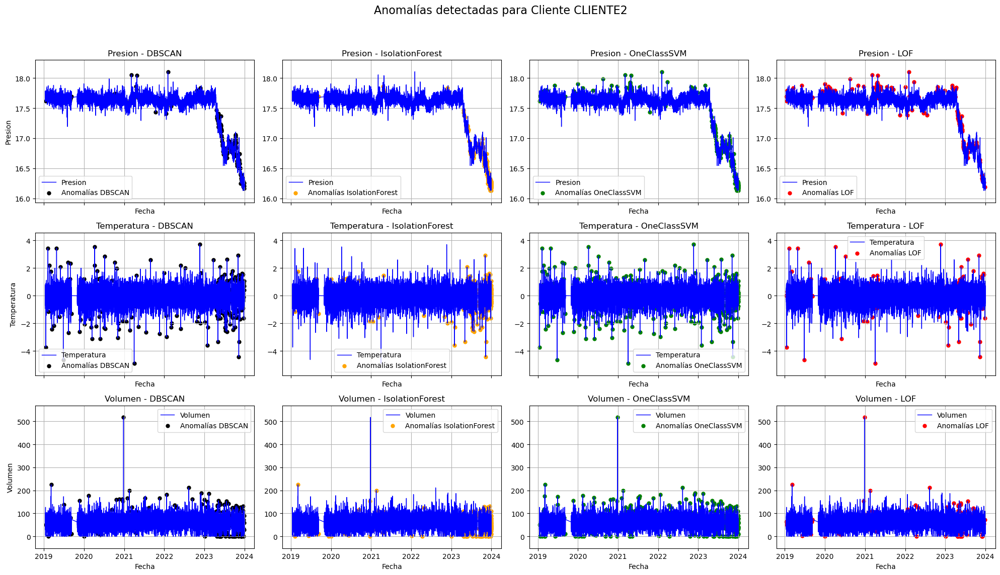

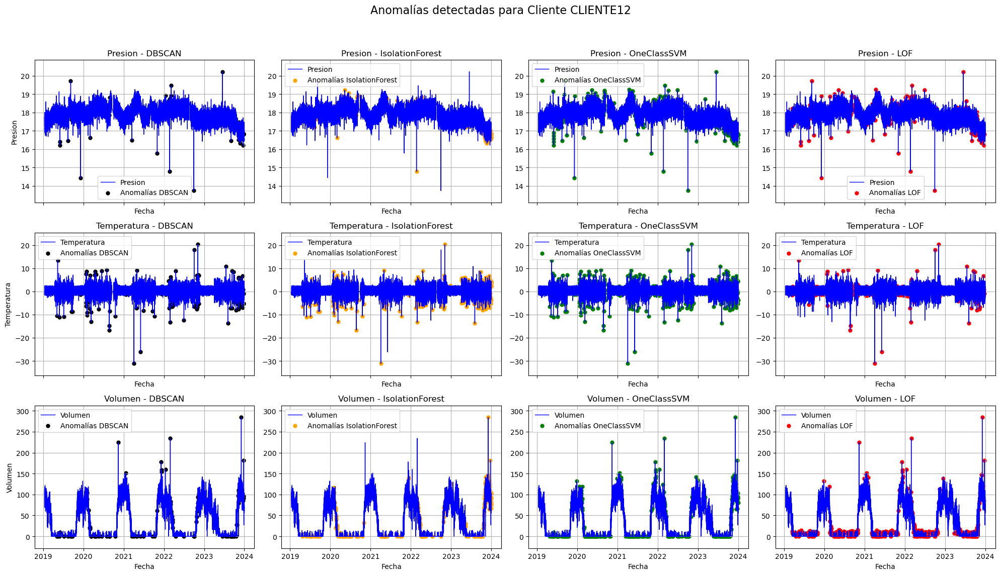

...

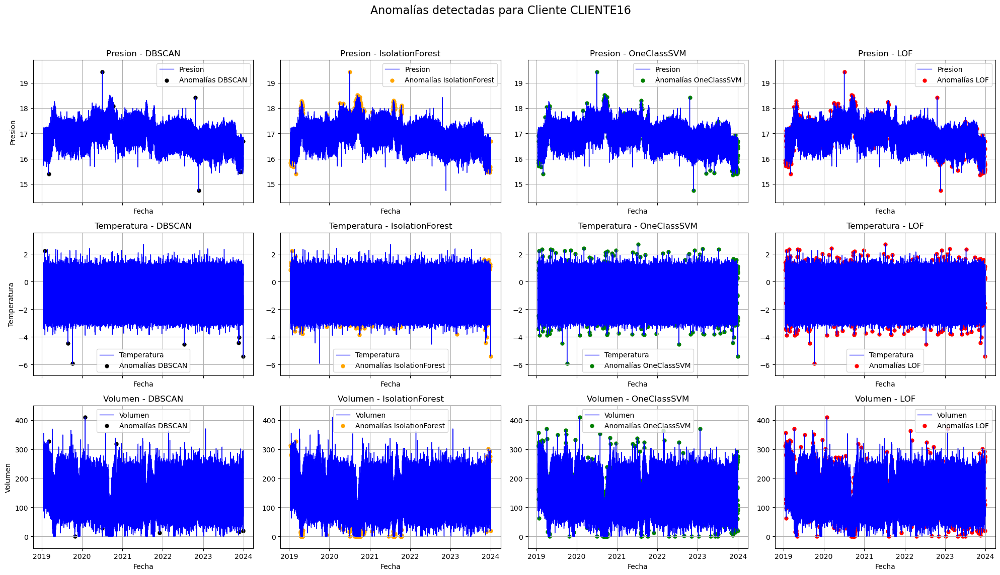

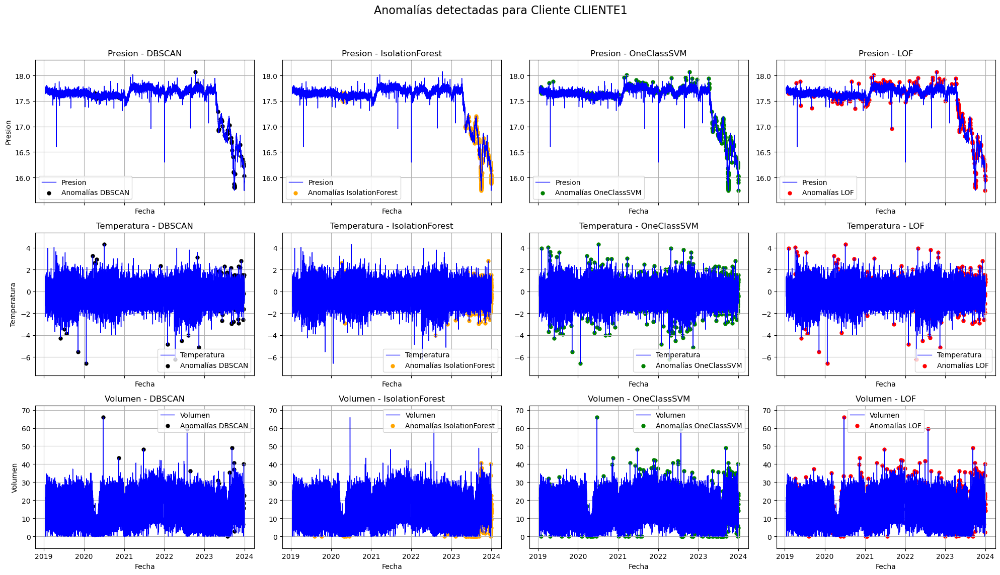

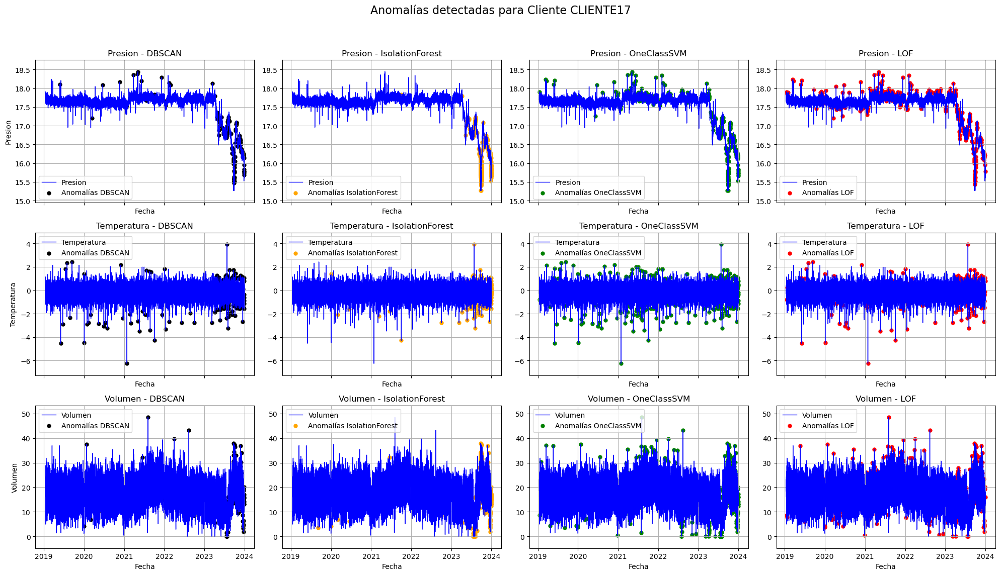

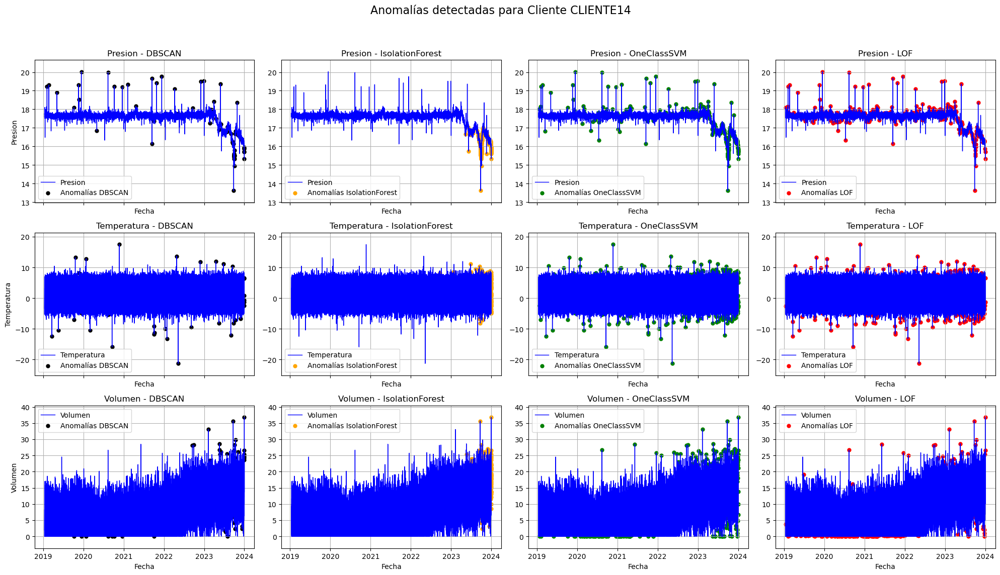

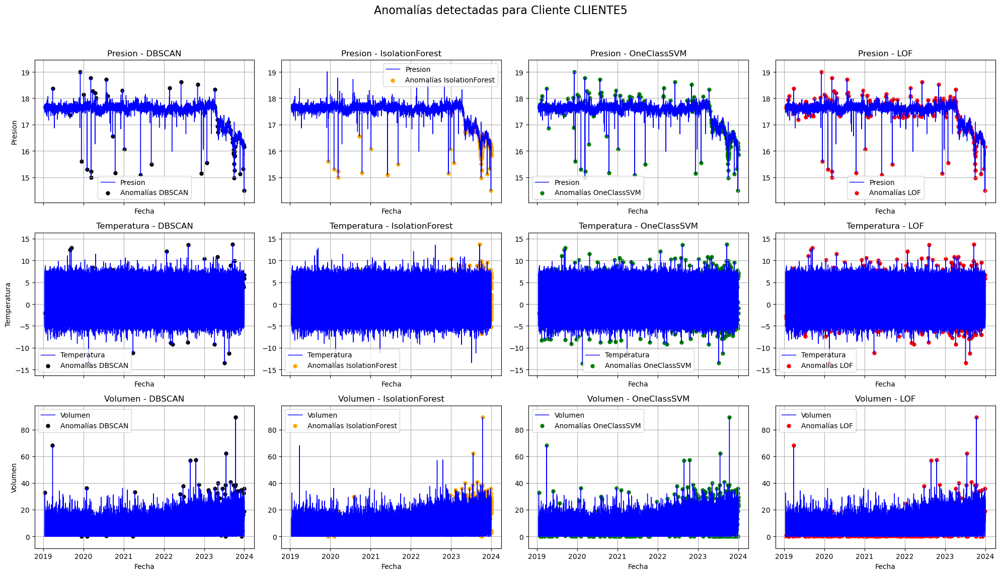

In [124]:
graficar_anomalias(df_anomalies, lista_pares_organizados)

**Comentarios**:

- *CLIENTE10* : Según Silhouette y Davies-Bouldin IsoForest es el mejor, pero este solo detecta las anomalias asociadas a bajos picos de presión, y altas temperaturas. Por loo tanto, y según los score, DBSCAN o ONECLASSSVM

-*CLIENTE13*: DBSCAN o ONECLASSSVM

-*CLIENTE18*:
    Silhouette: DBSCAN
    Davies-Bouldin: IsoForest
    Graficamente: En todos toma como valores anomalos desde el 2023. DBSCAN

-*CLIENTE2*:
    =Cliente18

-*CLIENTE18*:
    Silhouette: DBSCAN
    Davies-Bouldin: IsoForest
    Graficamente: En todos toma como valores anomalos desde el 2023. DBSCAN

## 2. Ingeniería de variables

df_corregido

In [120]:
df_corregido

,Fecha,Presion,Temperatura,Volumen,Cliente
0,2019-01-14 00:00:00,17.732563,0.575216,20.969751,CLIENTE1
1,2019-01-14 01:00:00,17.747776,0.893297,17.845739,CLIENTE1
2,2019-01-14 02:00:00,17.758916,0.613994,20.975914,CLIENTE1
3,2019-01-14 03:00:00,17.727940,0.204748,20.592299,CLIENTE1
4,2019-01-14 04:00:00,17.746484,0.198320,21.690626,CLIENTE1
...,...,...,...,...,...
870235,2023-12-31 19:00:00,15.751139,0.924379,204.457549,CLIENTE20
870236,2023-12-31 20:00:00,15.614858,0.471614,186.512096,CLIENTE20
870237,2023-12-31 21:00:00,15.598944,0.167901,204.456461,CLIENTE20
870238,2023-12-31 22:00:00,15.730040,0.722520,203.695596,CLIENTE20


In [ ]:
df = df_corregido.copy()

# Relación fisico-quimica
df['PVT_ratio'] = (df['Presion'] * df['Volumen']) / (df['Temperatura'] + 273.15)

# Derivadas y tasas de cambio
df['Delta_Presion'] = df['Presion'].diff()
df['Delta_Temperatura'] = df['Temperatura'].diff()
df['Delta_Volumen'] = df['Volumen'].diff()

# Tasas relativas (%)
df['Rate_Presion'] = df['Delta_Presion'] / df['Presion'].shift(1)
df['Rate_Temperatura'] = df['Delta_Temperatura'] / df['Temperatura'].shift(1)
df['Rate_Volumen'] = df['Delta_Volumen'] / df['Volumen'].shift(1)

# Variables temporales
df['Hora'] = df['Fecha'].dt.hour
df['DiaSemana'] = df['Fecha'].dt.dayofweek
df['FinDeSemana'] = df['DiaSemana'].isin([5,6]).astype(int)
# Variables temporales
df['Turno'] = pd.cut(df['Hora'], bins=[0,6,12,18,24], labels=['Noche','Mañana','Tarde','Noche'], right=False)

# Normas
df['Presion_Anomala'] = ((df['Presion'] <= 0) | (df['Presion'] > 80)).astype(int)  # ajusta el umbral real
df['Temperatura_Anomala'] = ((df['Temperatura'] < -20) | (df['Temperatura'] > 60)).astype(int)
df['Volumen_Anomalo'] = (df['Volumen'] < 0).astype(int)

In [ ]:
20222 y 2023

## Enfoque por pares

In [ ]:
from itertools import combinations

def evaluar_anomalias_por_pares_clientes(df_corregido):
    df_anomalies = pd.DataFrame()
    resultados = []

    # Obtener todos los pares únicos de clientes
    clientes = df_corregido['Cliente'].unique()
    pares_clientes = list(combinations(clientes, 2))

    for cliente_A, cliente_B in pares_clientes:
        # Extraer los datos de los dos clientes
        datos_A = df_corregido[df_corregido['Cliente'] == cliente_A].copy()
        datos_B = df_corregido[df_corregido['Cliente'] == cliente_B].copy()

        # Añadir una columna para identificar al cliente
        datos_A['Cliente_Grupo'] = f'Cliente_{cliente_A}'
        datos_B['Cliente_Grupo'] = f'Cliente_{cliente_B}'

        # Unir los dos DataFrames
        df_par = pd.concat([datos_A, datos_B])
        df_par = df_par[['Fecha', 'Cliente_Grupo', 'Presion', 'Temperatura', 'Volumen']].copy()

        # Escalar variables
        scaler = StandardScaler()
        features = df_par[['Presion', 'Temperatura', 'Volumen']].astype('float32')
        features_scaled = scaler.fit_transform(features)

        df_par_scaled = pd.DataFrame(features_scaled, columns=['Presion_scaled', 'Temperatura_scaled', 'Volumen_scaled'])
        df_par_scaled['Cliente_Grupo'] = df_par['Cliente_Grupo'].values
        df_par_scaled['Fecha'] = df_par['Fecha'].values
        df_par_scaled.set_index('Fecha', inplace=True)

        # Aplicar modelos
        modelos = {
            'DBSCAN': DBSCAN(eps=0.5, min_samples=5),
            'IsolationForest': IsolationForest(contamination=0.01, random_state=42),
            'OneClassSVM': OneClassSVM(nu=0.01, kernel='rbf', gamma='scale'),
            'LOF': LocalOutlierFactor(n_neighbors=20, contamination=0.01, novelty=True)
        }

        for nombre_modelo, modelo in modelos.items():
            if nombre_modelo == 'LOF':
                modelo.fit(features_scaled)
                labels = modelo.predict(features_scaled)
            else:
                labels = modelo.fit_predict(features_scaled)
            
            df_par_scaled[nombre_modelo] = [1 if label == -1 else 0 for label in labels]

            # Métricas de calidad (solo si hay al menos dos clases)
            etiquetas = df_par_scaled[nombre_modelo].values
            if len(set(etiquetas)) > 1:
                sil = silhouette_score(features_scaled, etiquetas)
                dbs = davies_bouldin_score(features_scaled, etiquetas)
            else:
                sil = np.nan
                dbs = np.nan

            resultados.append({
                'Par_Clientes': f'{cliente_A}-{cliente_B}',
                'Modelo': nombre_modelo,
                'Silhouette': sil,
                'Davies-Bouldin': dbs
            })

        # Guardar resultados del par
        df_par_scaled['Par_Clientes'] = f'{cliente_A}-{cliente_B}'
        df_anomalies = pd.concat([df_anomalies, df_par_scaled])

    df_resultados = pd.DataFrame(resultados)
    return df_anomalies.sort_index(), df_resultados


In [ ]:
## 